<img heigth="8" src="https://i.imgur.com/DTmSLPg.png" alt="chartsper">

<h1 align="left">🎸 Chartsper 🎮</h1>

<p align="left"><i>Supervised Fine-Tuning (SFT) for Guitar Note Recognition</i></p>

<p align="left">
  Joseph Vergel | <a href="https://joefavergel.dev/">joefavergel.dev</a>
  <br>
  <b>Last updated:</b> <i>11/04/2024</i>
  <br><br>
  <a target="_blank">
    <img src="https://github.com/QData/TextAttack/workflows/Github%20PyTest/badge.svg" alt="Testing">
  </a>
  <a href="https://img.shields.io/badge/version-0.1.0-blue.svg?cacheSeconds=2592000">
    <img src="https://img.shields.io/badge/version-0.1.0-blue.svg?cacheSeconds=2592000" alt="Version" height="18">
  </a>
</p><br>
<p align="left">
  <a href="#introduction">Introduction</a><br>
  <a href="#1-data-adquisition">1. Data Adquisition</a><br>
  <a href="#2-exploratory-data-analysis">2. Exploratory Data Analysis</a><br>
  <br>
</p>

---

The `chartsper` exploratory notebook documents the application of Supervised Fine-Tuning (SFT) to a pre-trained deep learning model for guitar note recognition in rhythm games. It covers the selection of a model suitable for audio processing, details preprocessing techniques like spectral normalization and explores model retraining with hyperparameter tuning and domain-specific augmentations.

<a id="1-data-extraction"></a>
# Introduction

In [1]:
import os
import glob
import json
import pathlib

from IPython.display import Audio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import pretty_midi
import librosa

In [2]:
try:
    import importlib

    __package__ = "chartsper"

    found = False
    while not found:
        os.chdir(os.path.join(os.getcwd(), os.pardir))
        found = bool(importlib.util.find_spec(__package__))
        if found:
            print(f"[INFO] WORKDIR: {os.path.join(os.getcwd(), os.pardir)}")
        continue
except ModuleNotFoundError as e:
    print("[ERROR] Verify WORKDIR execution: ", e)

[INFO] WORKDIR: /Users/joefaver/Codes/self/chartsper/..


In [3]:
import chartsper
from chartsper.io import read_midi
from chartsper.logging import logger
from chartsper.schemas import ChartSong, ChartFile, KIND_MAPPING

<a id="1-data-adquisition"></a>
# 1. Data Adquisition

To start, you can download some [chart pack](https://docs.google.com/spreadsheets/u/0/d/13B823ukxdVMocowo1s5XnT3tzciOfruhUVePENKc01o/htmlview?usp=drive_web&pli=1#) and put it in the `datalake/` directory.

In [4]:
FILEID = '1DsRIpbvicrGhAkLQ5qxASybNGuEJ_dB6'
FILENAME = 'Guitar Hero World Tour.7z'
!cd datalake/ && wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=$FILEID' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=$FILEID" -O "$FILENAME" && rm -rf /tmp/cookies.txt

--2024-04-16 23:32:51--  https://docs.google.com/uc?export=download&confirm=&id=1DsRIpbvicrGhAkLQ5qxASybNGuEJ_dB6
Resolving docs.google.com (docs.google.com)... ^C


<a id="2-exploratory-data-analysis"></a>
# 2. Exploratory Data Analysis

## 2.1 Audio Files

From [common audio file info](https://github.com/TheNathannator/GuitarGame_ChartFormats/blob/f1047b4efbbf92c065236dd0b53fe55a65f805fd/doc/FileFormats/Audio%20Files.md?plain=1#L8) TheNathannator et al. (2024) we can extract the following information:


### 2.1.1 Recommended Supported Formats

| File type | Recommended Quality  | Comments
| :-------- | :------------------  | :-------
| .opus     | 80 kbps              | Highly recommended for its file size to quality ratio.
| .ogg      | Quality 8 (256 kbps) | Generally fine for single-file audio charts. For stems, consider using .opus instead.
| .mp3      | 320 kbps             | Not very recommended for new charts, use .ogg or .opus instead.


### 2.1.2 File Names

There are a number of audio file names reserved for use as specific audio tracks.

| File name           | Description
| :--------           | :----------
| `preview`           | Preview audio to play on the song select menu.
| `song`              | Background audio not associated with any particular instrument, or the main audio stream if it is the only one present..
| `guitar`            | Lead guitar audio, or the main audio stream if it is the only one present.
| `rhythm`            | Rhythm guitar audio, or bass guitar audio if no rhythm guitar track is present.
| `bass`              | Bass guitar audio.
| `keys`              | Keys audio.
| `drums`             | Drums audio as a single stem.<br>Should be ignored if numbered stems (`drums_#`) exist.
| `drums_1`           | Drums audio for the kick drum, plus snare, tom, and cymbal audio if 2-4 are not present.
| `drums_2`           | Drums audio for the snare drum, plus tom and cymbal audio if 3 and 4 are not present.
| `drums_3`           | Drums audio for toms, plus cymbal audio if 4 is not present.
| `drums_4`           | Drums audio for cymbals.
| `vocals`            | Vocals audio as a single stem.<br>Should be ignored if numbered stems (`vocals_#`) exist.
| `vocals_1`          | Main vocals audio.
| `vocals_2`          | Secondary vocals audio.
| `vocals_explicit`   | Contains only explicit lyrics which have been removed from the vocals audio.
| `vocals_explicit_1` | Contains only explicit lyrics which have been removed from the main vocals audio.
| `vocals_explicit_2` | Contains only explicit lyrics which have been removed from the secondary vocals audio.
| `crowd`             | Background crowd noise/singing audio.

In [5]:
DATASET = 'Guitar Hero World Tour'
DATAPATH = f'datalake/{DATASET}'
PROCESSED = f'datalake/{DATASET.replace(' ', '_').lower()}_processed/'
ALLOWED_EXTENSIONS = ['.mp3', '.ogg', '.mid', '.chart', '.ini']

if os.path.exists(DATAPATH):
    os.makedirs(PROCESSED, exist_ok=True)

In [6]:
titles = {
    path_.parent._str.split('/')[-1]: path_.parent
    for path in glob.glob(os.path.join(DATAPATH, '**/**'))
    if (path_ := pathlib.Path(path)) and path_.is_file() and path_.suffix in ['.ini']
}
chart_file_paths = {
    name: [
        path_ for path in glob.glob(os.path.join(path, '*'))
        if (path_ := pathlib.Path(path)) and path_.is_file() and path_.suffix.lower() in ALLOWED_EXTENSIONS]
    for name, path in titles.items()
}

In [7]:
artist_name = 'Eagles'
artist_clips = dict(filter(lambda item: item[0].startswith(artist_name), chart_file_paths.items()))
chart_name = list(artist_clips.keys())[0]

print(chart_name, '\n', '-'*len(chart_name))
for clip in artist_clips[chart_name]:
    print(f' * {clip.name}')

clip_path = artist_clips[chart_name][9]
clip_name = os.path.join(str(clip_path.parent).split('/')[-1], clip_path.name)
print('\n', clip_name, '\n', '-'*len(clip_name))

y, sr = librosa.load(clip_path)
Audio(data=y, rate=sr)

Eagles - Hotel California 
 -------------------------
 * drums_3.ogg
 * drums_2.ogg
 * drums_1.ogg
 * drums_4.ogg
 * unedited_notes.mid
 * song.ogg
 * crowd.ogg
 * notes.mid
 * vocals.ogg
 * preview.ogg
 * rhythm.ogg
 * guitar.ogg
 * song.ini

 Eagles - Hotel California/preview.ogg 
 -------------------------------------


In [8]:
chart_file_kinds = ['guitar', 'song', 'notes', 'preview']
allowed_extensions = ['.chart', '.mid', '.ogg']

char_path = dict(filter(lambda item: item[0].startswith(artist_name), titles.items()))
chart_name = list(char_path.keys())[0]
artist, title = tuple(chart_name.split(' - '))

for name, paths in dict(filter(lambda item: item[0].startswith(artist_name), chart_file_paths.items())).items():
    tmp = [path for path in paths if any(map(path.stem.startswith, chart_file_kinds)) and path.suffix.lower() in allowed_extensions]
    filtered = {
        file_kind: [
            ChartFile(**{
                'path': path,
                'file_type': {
                    'kind': KIND_MAPPING.get(file_kind) if file_kind != 'song' else KIND_MAPPING.get(file_kind).get(path.suffix),
                    'extension': path.suffix
                },
                'chart_type': file_kind
            })
            for path in tmp
            if path.stem.startswith(file_kind)
        ] for file_kind in chart_file_kinds}

chart_song = ChartSong(title=title, artist=artist, path=char_path[list(char_path.keys())[0]], **filtered)
y, sr = librosa.load(clip_path)
print(json.dumps(json.loads(chart_song.json()), indent=4))

{
    "title": "Hotel California",
    "artist": "Eagles",
    "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California",
    "guitar": [
        {
            "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California/guitar.ogg",
            "file_type": {
                "kind": "audio",
                "extension": ".ogg"
            },
            "chart_type": "guitar",
            "data": null
        }
    ],
    "song": [
        {
            "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California/song.ogg",
            "file_type": {
                "kind": "audio",
                "extension": ".ogg"
            },
            "chart_type": "song",
            "data": null
        }
    ],
    "notes": [
        {
            "path": "datalake/Guitar Hero World Tour/Eagles - Hotel California/notes.mid",
            "file_type": {
                "kind": "notes",
                "extension": ".mid"
            },
            "chart_type": "notes"

2024-04-16 23:33:50,273  [chartsper] [INFO]  Mel spectrogram shape: (128, 17430)


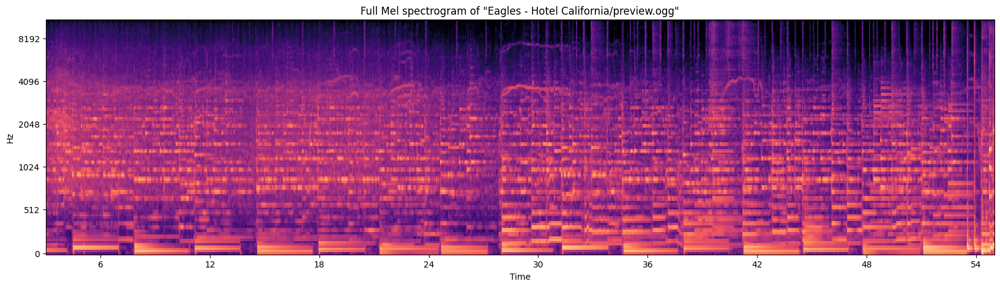

In [9]:
y, sr = librosa.load(chart_song.preview[0].path)
melspec = librosa.power_to_db(
    librosa.feature.melspectrogram(y=y, sr=sr),
    ref=np.max
)
logger.info(f"Mel spectrogram shape: {melspec.shape}")

fig, ax = plt.subplots(figsize=(20, 5))
librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=ax)
ax.set(title=f'Full Mel spectrogram of \"{clip_name}\"')
ax.set_xlim([3, 55])
plt.show()

2024-04-16 23:33:52,091  [chartsper] [INFO]  Mel spectrogram shape: (128, 17474)


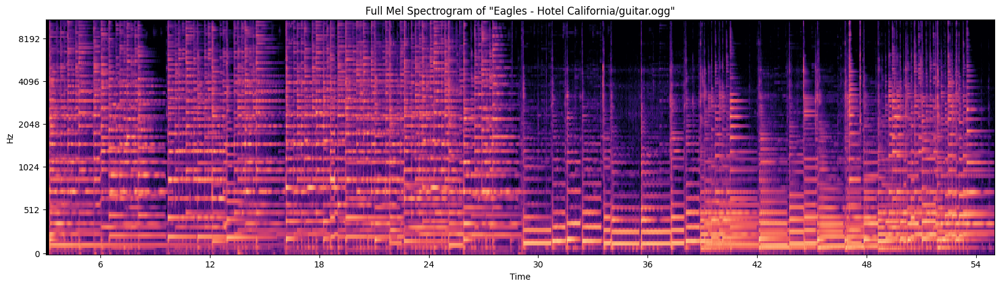

In [10]:
clip_name = os.path.join(str(chart_song.guitar[0].path.parent).split('/')[-1], chart_song.guitar[0].path.name)
y, sr = librosa.load(chart_song.guitar[0].path)
melspec = librosa.power_to_db(
    librosa.feature.melspectrogram(y=y, sr=sr),
    ref=np.max
)
logger.info(f"Mel spectrogram shape: {melspec.shape}")

fig, ax = plt.subplots(figsize=(20, 5))
librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=ax)
ax.set(title=f'Full Mel Spectrogram of \"{clip_name}\"')
ax.set_xlim([3, 55])
plt.show()

The simple approach is to load the data and visualize it using [efficient patch generation](https://librosa.org/doc/latest/auto_examples/plot_patch_generation.html#sphx-glr-auto-examples-plot-patch-generation-py). We can use the `librosa` library to load the data and `matplotlib` to plot it.

In [11]:
frame_length = librosa.time_to_frames(5.0)
hop_length = librosa.time_to_frames(0.10)
logger.info(f"Frame length={frame_length}, hop length={hop_length}")

patches = librosa.util.frame(
    melspec,
    frame_length=frame_length,
    hop_length=hop_length
)
logger.info(f"Patch array shape: {patches.shape}")

2024-04-16 23:33:56,151  [chartsper] [INFO]  Frame length=215, hop length=4
2024-04-16 23:33:56,151  [chartsper] [INFO]  Patch array shape: (128, 215, 4315)
2024-04-16 23:33:56,151  [chartsper] [INFO]  Patch array shape: (128, 215, 4315)


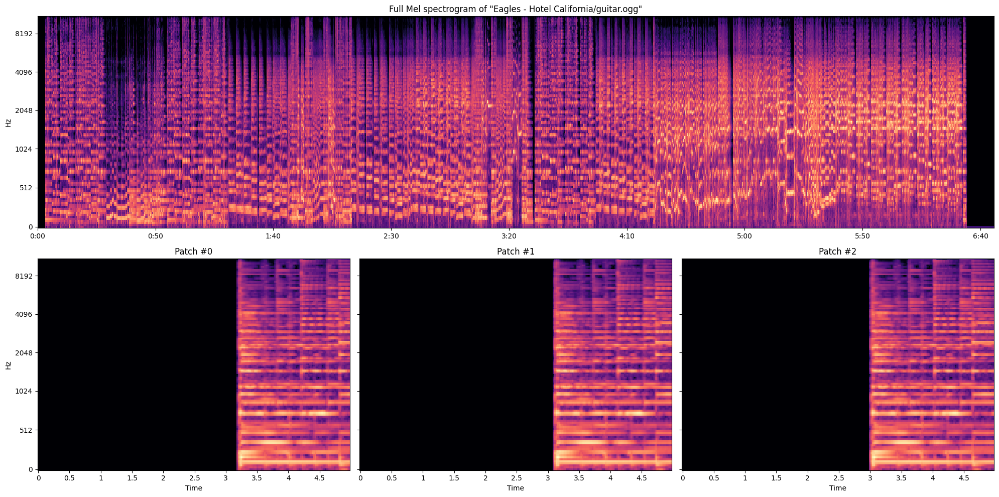

In [12]:
fig, ax = plt.subplot_mosaic([list("AAA"), list("012")], figsize=(20, 10))

librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=ax["A"])
ax["A"].set(title=f'Full Mel spectrogram of \"{clip_name}\"', xlabel=None)

for index in [0, 1, 2]:
    librosa.display.specshow(
        patches[..., index],
        x_axis='time',
        y_axis='mel',
        ax=ax[str(index)]
    )
    ax[str(index)].set(title=f"Patch #{index}")
    ax[str(index)].label_outer()
plt.tight_layout()

## 2.2 Chart Files

There are 0 time signature changes
There are 4 instruments: PART GUITAR, PART BASS, PART DRUMS, PART VOCALS

PART GUITAR
-----------
  * 6163 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0


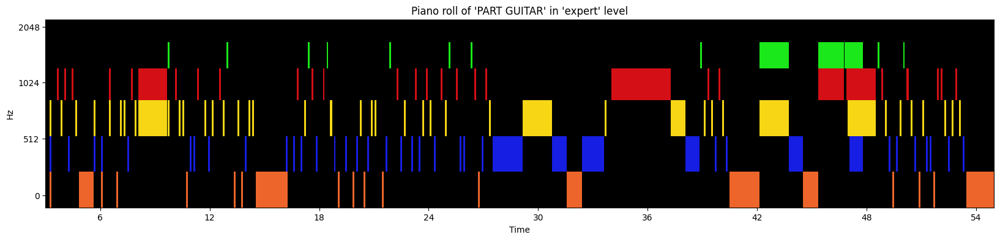

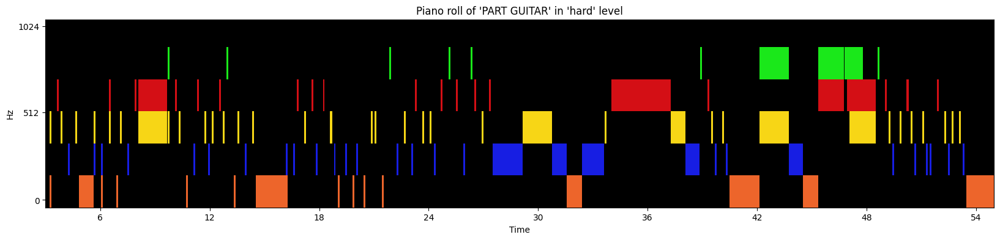

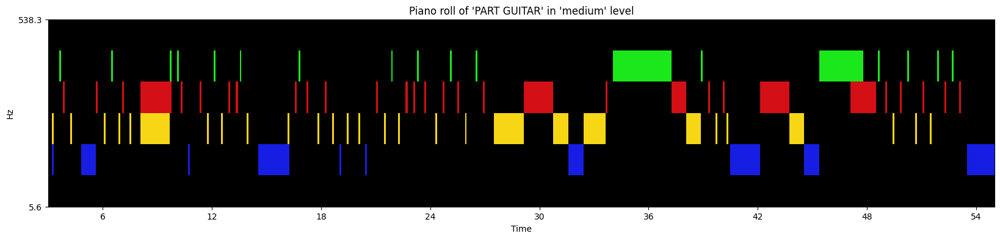

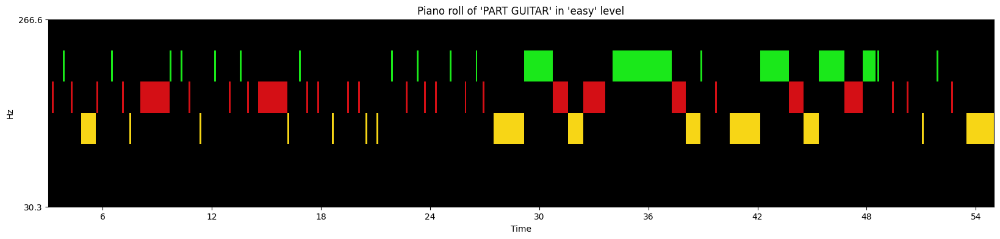


PART BASS
---------
  * 4788 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0

PART DRUMS
----------
  * 4065 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0

PART VOCALS
-----------
  * 493 notes
  * 0 pitch bends
  * 0 control changes
  * Program -> 0


In [34]:
import warnings

import matplotlib

warnings.filterwarnings('ignore')

LEVEL_MAPING = {
    # 'markers': (103, 127)
    'expert': {
        'pitch_lims': (95, 100),
        'colors': ['#000000', '#1ae81a', '#d40f15', '#f7d616', '#171ee3', '#ed652b']
    },
    'hard': {
        'pitch_lims': (83, 88),
        'colors': ['#000000', '#1ae81a', '#d40f15', '#f7d616', '#171ee3', '#ed652b']
    },
    'medium': {
        'pitch_lims': (71, 76),
        'colors': ['#000000', '#1ae81a', '#d40f15', '#f7d616', '#171ee3']
    },
    'easy': {
        'pitch_lims': (59, 64),
        'colors': ['#000000', '#1ae81a', '#d40f15', '#f7d616']
    },
}


def get_notes_by_colors(pm, start_pitch, end_pitch, fs=100, y_axis='mel'):
    matrix = pm.get_piano_roll(fs)[start_pitch:end_pitch + 1]
    for idx, row in enumerate(matrix):
        for index, value in enumerate(row):
            if value > 0:
                row[index] = idx
    if y_axis == 'cqt_note':
        return matrix[::-1]
    else:
        return matrix


def plot_piano_roll(pm, start_pitch, end_pitch, fs=100, figsize=(20, 4), cmap=None, ax=None, y_axis='mel'):
    if ax is None:
        fig, ax = plt.subplots(figsize=figsize)

    img = librosa.display.specshow(
        get_notes_by_colors(pm, start_pitch, end_pitch, fs=100, y_axis=y_axis),
        hop_length=1,
        sr=fs,
        x_axis='time',
        y_axis=y_axis,
        fmin=pretty_midi.note_number_to_hz(start_pitch),
        cmap=cmap,
        ax=ax
    )
    return ax


pm = pretty_midi.PrettyMIDI(str(chart_song.notes[0].path))

print('There are {} time signature changes'.format(len(pm.time_signature_changes)))
print(f'There are {len(pm.instruments)} instruments: {", ".join([instrument.name for instrument in pm.instruments])}')
for instrument in pm.instruments:
    print(f"\n{instrument.name}\n{len(instrument.name) * '-'}")
    print(f"  * {len(instrument.notes)} notes")
    print(f"  * {len(instrument.pitch_bends)} pitch bends")
    print(f"  * {len(instrument.control_changes)} control changes")
    print(f"  * Program -> {instrument.program}")

    if instrument.name == 'PART GUITAR':
        for level in LEVEL_MAPING.keys():
            ax = plot_piano_roll(
                instrument,
                *LEVEL_MAPING.get(level)['pitch_lims'],
                cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get(level)['colors']),
                y_axis='mel'
            )
            ax.set_title(f"Piano roll of '{instrument.name}' in '{level}' level")
            # ax.set_xlim(3, 23)
            # ax.set_xlim(27.5, 39)
            ax.set_xlim(3, 55)
            plt.show()


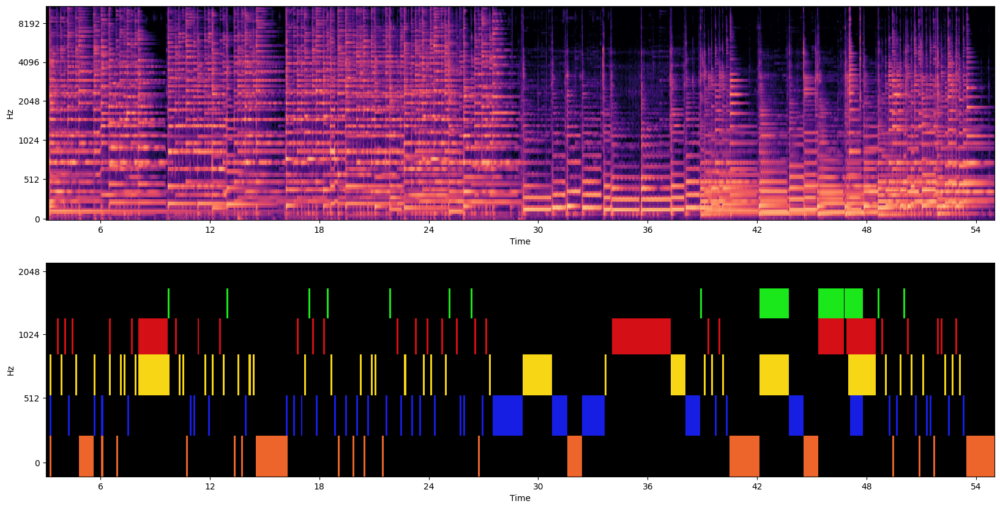

In [35]:
fig, axes = plt.subplots(2, 1, figsize=(20, 10))
librosa.display.specshow(melspec, x_axis='time', y_axis='mel', ax=axes[0])
axes[1] = plot_piano_roll(
    pm.instruments[0],
    *LEVEL_MAPING.get('expert')['pitch_lims'],
    cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get('expert')['colors']),
    y_axis='mel',
    ax=axes[1]
)
# ax.set_title(f"Piano roll of '{pm.instruments[0].name}' in 'expert' level")
# ax.set_xlim(3, 23)
# ax.set_xlim(27.5, 39)
for ax in axes:
    ax.set_xlim(3, 55)
plt.show()



In [21]:
chartspec = get_notes_by_colors(pm.instruments[0], *LEVEL_MAPING.get('expert')['pitch_lims'])
frame_length = librosa.time_to_frames(5.0)
hop_length = librosa.time_to_frames(0.10)
print(f"Frame length={frame_length}, hop length={hop_length}")

patches = librosa.util.frame(
    chartspec,
    frame_length=frame_length,
    hop_length=hop_length
)
print(f"Patch array shape: {patches.shape}")

Frame length=215, hop length=4
Patch array shape: (6, 215, 9796)


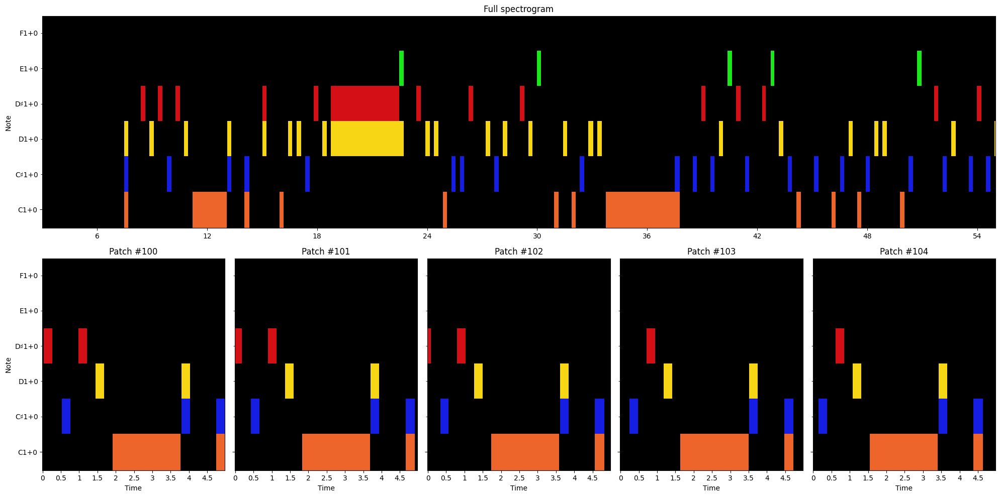

In [25]:
fig, ax = plt.subplot_mosaic([list("A"*5), ['100', '101', '102', '103', '104']], figsize=(20, 10))

librosa.display.specshow(
    chartspec,
    x_axis='time',
    y_axis='cqt_note',
    cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get('expert')['colors']),
    ax=ax["A"]
)
ax["A"].set(title='Full spectrogram', xlabel=None)
ax["A"].set_xlim([3, 55])

for index in [100, 101, 102, 103, 104]:
    librosa.display.specshow(
        patches[..., index],
        x_axis='time',
        y_axis='cqt_note',
        cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get('expert')['colors']),
        ax=ax[str(index)]
    )
    ax[str(index)].set(title=f"Patch #{index}")
    ax[str(index)].label_outer()
plt.tight_layout()
plt.show()

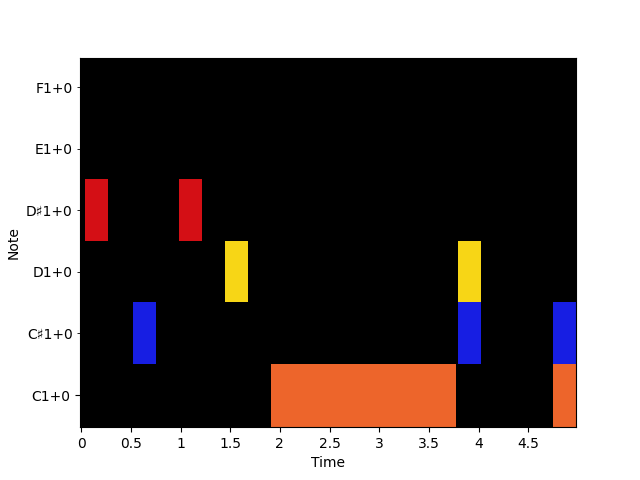

In [27]:
%matplotlib ipympl
# We'll plot the first patch to create the display object,
# then animate the rest.

# sphinx_gallery_thumbnail_number = 2

fig, ax = plt.subplots()
mesh = librosa.display.specshow(
    patches[..., 100],
    x_axis='time',
    y_axis='cqt_note',
    cmap=matplotlib.colors.ListedColormap(LEVEL_MAPING.get('expert')['colors']),
    ax=ax
)
#     x_axis='time',
#     y_axis='mel',
#     ax=ax
# )


# This helper function is used to render each frame of the animation
# Updating the mesh object is much more efficient than rendering an
# entirely new spectrogram for each frame!
#
# Note that the "time" axis of this figure corresponds to the time
# within the patch; not the absolute time in the original signal.
#
def _update(num):
    mesh.set_array(patches[..., num])
    return (mesh,)


ani = animation.FuncAnimation(
    fig,
    func=_update,
    frames=patches.shape[-1],
    interval=100,  # 100 milliseconds = 1/10 sec
    blit=True
)

In [71]:
# [note for note in pm.instruments[0].notes if 96 <= note.pitch <= 102]]
l = [0,1,2,3,4,5,6,7,8,9]
l[3:7]

[3, 4, 5, 6]

In [77]:
pm.instruments[0].get_piano_roll(100).shape
# pm.get_piano_roll(fs)[start_pitch:end_pitch]

(128, 39396)

In [67]:
np.unique([note.pitch for note in pm.instruments[0].notes], return_counts=True)

(array([ 60,  61,  62,  66,  72,  73,  74,  75,  77,  78,  84,  85,  86,
         87,  88,  89,  90,  96,  97,  98,  99, 100, 101, 102, 103, 116]),
 array([143, 179, 107, 429, 124, 220, 247, 101,  39, 545,  95, 202, 253,
        225, 143, 233, 538, 148, 284, 360, 314, 174, 660, 386,   2,  12]))

In [128]:
LEVEL_MAPING = {
    # 'markers': (103, 127)
    'expert': (96, 103),
    'hard': (84, 91),
    'medium': (72, 79),
    'easy': (60, 66),
}

def plot_chart_notes(instrument, level, fs=100, figsize=(20, 4)):
    fig, ax = plt.subplots(figsize=figsize)
    img = librosa.display.specshow(
        instrument.get_piano_roll(fs)[level[0]:level[1]],
        hop_length=1,
        sr=fs,
        x_axis='time',
        y_axis='cqt_note',
        ax=ax
    )
    return fig, ax, img

/var/folders/4_/n20qb35j03bb6b_f62lnx6q40000gn/T/ipykernel_53662/3212315408.py:4: UserWarning: Frequency axis exceeds Nyquist. Did you remember to set all spectrogram parameters in specshow?
  img = librosa.display.specshow(


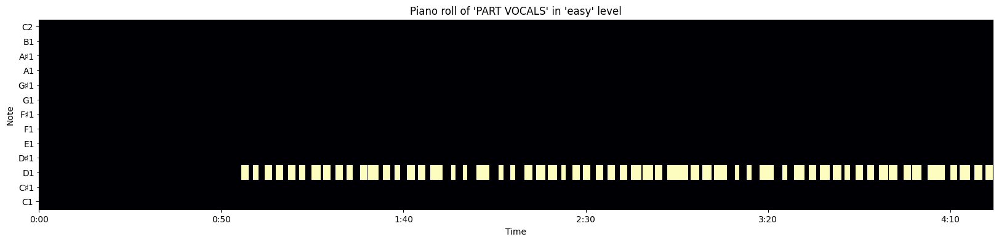

In [129]:
fig, ax, img = plot_piano_roll(instrument, 103, 116)
ax.set_title(f"Piano roll of '{instrument.name}' in '{level}' level")
# ax.set_xlim(3, 13)
plt.show()

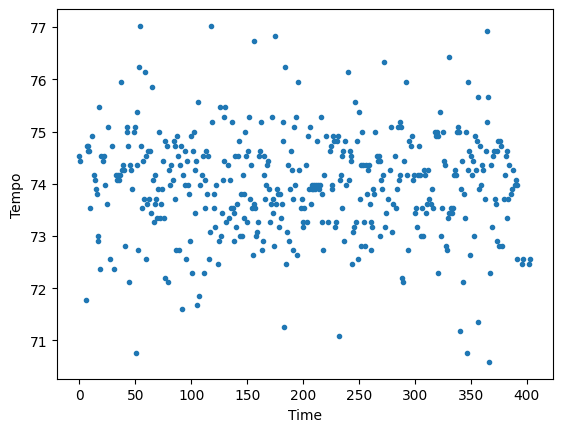

In [130]:
# Plot the tempo changes over time
# Many MIDI files won't have more than one tempo change event,
# but this particular file was transcribed to somewhat closely match the original song.
times, tempo_changes = pm.get_tempo_changes()
plt.plot(times, tempo_changes, '.')
plt.xlabel('Time')
plt.ylabel('Tempo');


In [103]:
from visual_midi import Plotter
from visual_midi import Preset
from pretty_midi import PrettyMIDI


class CustomPlotter(Plotter):
    def _get_qpm(self, pm: PrettyMIDI):
        """
        Returns the first tempo change that is not zero, raises exception
        if not found or multiple tempo present.
        """
        qpm = None
        for tempo_change in pm.get_tempo_changes():
            if tempo_change.min() and tempo_change.max() and tempo_change.min() == tempo_change.max():
                if qpm:
                    raise Exception("Multiple tempo changes are not supported "
                                    + str(pm.get_tempo_changes()))
                qpm = tempo_change.min()
            else:
                qpm = pm.estimate_tempo()

        return qpm


preset = Preset(plot_width=850)
plotter = CustomPlotter(preset, plot_max_length_bar=4)
pm = PrettyMIDI(str(chart_song.notes[0].path))
plotter.show_notebook(pm)

Loading BokehJS ...

Column(id='3510', ...)

In [22]:
# import mido

# # mid = read_midi(chart_song.notes[0].path)
# # mid = mido.MidiFile(chart_song.notes[0].path)

# for i, track in enumerate(mid.tracks):
#     print('Track {}: {}'.format(i, track.name))
#     for msg in track:
#         print(msg)

In [12]:
# from visual_midi import Plotter
# from visual_midi import Preset
# from pretty_midi import PrettyMIDI

# preset = Preset(plot_width=850)
# plotter = Plotter(preset, plot_max_length_bar=4)
# pm = PrettyMIDI(str(chart_song.notes[0].path))
# plotter.show_notebook(pm)

# # Converting to PrettyMidi from another library, like Magenta note-seq
# import magenta.music as mm
# pm = mm.midi_io.note_sequence_to_pretty_midi(sequence)
# plotter = Plotter()
# plotter.show(pm, "/tmp/example-02.html")